# MagNav.jl Demonstration Notebook
This notebook provides a demonstration of some of the key functions provided in MagNav.jl: https://github.com/MIT-AI-Accelerator/MagNav.jl

Feel free to change any parameters of interest.

## Import packages and DataFrames

The DataFrames listed below provide useful information about the flight data (collected by Sander Geophysics Ltd. (SGL) in 2020) and magnetic anomaly maps.

Dataframe  | Description
:--------- | :----------
`df_map`   | map files relevant for SGL flights
`df_comp`  | SGL calibration flight lines
`df_flight`| SGL flight files
`df_all`   | all flight lines
`df_nav`   | all *navigation-capable* flight lines
`df_event` | pilot-recorded in-flight events

In [1]:
cd(@__DIR__)    # 디렉토리 설정
# 패키지를 현재 세션에 로드함
using MagNav
using CSV, DataFrames
using Plots: plot, plot!
using Random: seed!
using Statistics: mean, median, std
seed!(33); # 시드 설정
include("dataframes_setup.jl"); # 현재 스크립터에 dataframes_setup.jl 파일 내용을 포함시킴
# 여러 CSV 파일에서 데이터를 로드하여 DataFrame으로 변환


Row,flight,line,t_start,t_end,full_line,map_name,map_type,line_alt
,Symbol,Float64,Float64,Float64,Bool,Symbol,Symbol,Int64
1,Flt1003,1003.01,50047.0,50713.0,false,Eastern_395,HAE,395
2,Flt1003,1003.02,50713.0,54497.0,true,Eastern_395,HAE,398
3,Flt1003,1003.04,55835.0,59475.0,false,Eastern_395,HAE,800
4,Flt1003,1003.07,60105.0,60243.0,true,Renfrew_395,HAE,396
5,Flt1003,1003.08,60243.0,64586.0,true,Renfrew_395,HAE,397
6,Flt1004,1004.01,44700.0,45175.3,false,Eastern_395,HAE,824
7,Flt1004,4019.0,45175.4,45746.4,true,Eastern_395,HAE,797
8,Flt1004,4018.0,45901.4,46489.1,true,Eastern_395,HAE,798
9,Flt1004,4017.0,46600.8,47185.9,true,Eastern_395,HAE,799


## Flight line selection

Select Flight 1006 (see [readme](https://github.com/MIT-AI-Accelerator/MagNav.jl/blob/master/readmes/Flt1006_readme.txt)) and gather the [`XYZ20` data structure](https://mit-ai-accelerator.github.io/MagNav.jl/stable/structs/#MagNav.XYZ20), which contains the GPS-based trajectory [`Traj` data structure](https://mit-ai-accelerator.github.io/MagNav.jl/stable/structs/#MagNav.Traj), inertial navigation system [`INS` data structure](https://mit-ai-accelerator.github.io/MagNav.jl/stable/structs/#MagNav.INS), flight information, magnetometer readings, and auxilliary sensor data.

비행 1006을 선택하고([읽기](https://github.com/MIT-AI-Accelerator/MagNav.jl/blob/master/readmes/Flt1006_readme.txt) 참조) GPS 기반 궤적 [`Traj` 데이터 구조](https://mit-ai-accelerator.github.io/MagNav.jl/stable/structs/#MagNav.Traj), 관성 항법 시스템 [`INS` 데이터 구조](https://mit-ai-accelerator.github.io/MagNav.jl/stable/structs/#MagNav.INS), 비행 정보, 자력계 수치 및 보조 센서 데이터가 포함된 [`XYZ20` 데이터 구조](https://mit-ai-accelerator.github.io/MagNav.jl/stable/structs/#MagNav.XYZ20)를 수집합니다.

In [2]:
flight = :Flt1006 # select flight, full list in df_flight
xyz    = get_XYZ(flight,df_flight); # load flight data

┌ Info: reading in data: /home/daehwa/.julia/artifacts/c3f3d3462514a6c52576cf8017a650ea9d10e64b/sgl_2020_train/Flt1006_train.h5
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/get_XYZ.jl:1031
┌ Info: radar field contains NaNs
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/get_XYZ.jl:1333


┌ Info: topo field contains NaNs
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/get_XYZ.jl:1333
┌ Info: drape field contains NaNs
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/get_XYZ.jl:1333
┌ Info: mag_6_uc field contains NaNs
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/get_XYZ.jl:1336
┌ Info: ogs_mag field contains NaNs
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/get_XYZ.jl:1333
┌ Info: ogs_alt field contains NaNs
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/get_XYZ.jl:1333


The `xyz` flight data struct is of type `MagNav.XYZ20` (for the 2020 SGL flight data collection), which is a subtype of `MagNav.XYZ` (the abstract type for any flight data in MagNav.jl). There are 76 fields, which can be accessed using dot notation. Note that `xyz` holds all the flight data from the HDF5 file, but Boolean indices can be used as a mask to return specific portion(s) of flight data.

xyz` 비행 데이터 구조체는 2020년 SGL 비행 데이터 수집을 위한 `MagNav.XYZ20` 유형이며, 이는 `MagNav.XYZ`의 하위 유형입니다(MagNav.jl의 모든 비행 데이터에 대한 추상 유형). 76개의 필드가 있으며, 점 표기법을 사용하여 액세스할 수 있습니다. xyz`는 HDF5 파일의 모든 비행 데이터를 보유하지만, 부울 인덱스를 마스크로 사용하여 비행 데이터의 특정 부분을 반환할 수 있습니다.

In [3]:
typeof(xyz)

MagNav.XYZ20{Int64, Float64}

In [11]:
xyz.traj

MagNav.Traj{Int64, Float64}(108318, 0.1, [46100.0, 46100.1, 46100.2, 46100.3, 46100.4, 46100.5, 46100.6, 46100.7, 46100.8, 46100.9  …  57921.1, 57921.2, 57921.3, 57921.4, 57921.5, 57921.6, 57921.7, 57921.8, 57921.9, 57922.0], [0.7913336738816428, 0.7913343179081369, 0.7913349619346308, 0.7913356059611247, 0.7913362499876189, 0.7913368940141128, 0.7913375380406067, 0.7913381838124299, 0.7913388278389241, 0.791339471865418  …  0.7911783692488126, 0.7911778735753051, 0.7911773761564683, 0.7911768787376314, 0.7911763830641239, 0.7911758856452871, 0.7911753829904625, 0.7911748785903087, 0.7911743741901549, 0.7911738680446717], [-1.3208507527630409, -1.320850220437619, -1.3208496898575264, -1.3208491575321046, -1.3208486269520119, -1.32084809462659, -1.3208475623011682, -1.3208470299757464, -1.3208464976503245, -1.3208459653249027  …  -1.3211145296088824, -1.3211135539698307, -1.321112585312096, -1.321111609673044, -1.3211106340339922, -1.3211096618855989, -1.321108693227864, -1.321107722824

In [4]:
fieldnames(MagNav.XYZ20)


(:traj, :ins, :flux_a, :flux_b, :flux_c, :flux_d, :flight, :line, :year, :doy, :utm_x, :utm_y, :utm_z, :msl, :baro, :diurnal, :igrf, :mag_1_c, :mag_1_lag, :mag_1_dc, :mag_1_igrf, :mag_1_uc, :mag_2_uc, :mag_3_uc, :mag_4_uc, :mag_5_uc, :mag_6_uc, :ogs_mag, :ogs_alt, :ins_wander, :ins_roll, :ins_pitch, :ins_yaw, :roll_rate, :pitch_rate, :yaw_rate, :ins_acc_x, :ins_acc_y, :ins_acc_z, :lgtl_acc, :ltrl_acc, :nrml_acc, :pitot_p, :static_p, :total_p, :cur_com_1, :cur_ac_hi, :cur_ac_lo, :cur_tank, :cur_flap, :cur_strb, :cur_srvo_o, :cur_srvo_m, :cur_srvo_i, :cur_heat, :cur_acpwr, :cur_outpwr, :cur_bat_1, :cur_bat_2, :vol_acpwr, :vol_outpwr, :vol_bat_1, :vol_bat_2, :vol_res_p, :vol_res_n, :vol_back_p, :vol_back_n, :vol_gyro_1, :vol_gyro_2, :vol_acc_p, :vol_acc_n, :vol_block, :vol_back, :vol_srvo, :vol_cabt, :vol_fan)

Here a map is selected, then `df_nav` is filtered into `df_options` to ensure that the selected flight line(s) both corresponds with the selected flight (`:Flt1006`) and exists on the map (`:Eastern_395`). The full list of SGL flights is in `df_flight`, the full list of maps is in `df_map`, and the full list of navigation-capable flight lines is in `df_nav`.

여기서 지도를 선택한 다음 `df_nav`를 `df_options`로 필터링하여 선택한 비행선이 선택한 항공편(`:Flt1006`)과 일치하고 지도(`:Eastern_395`)에 존재하는지 확인합니다. SGL 항공편의 전체 목록은 `df_flight`에, 지도의 전체 목록은 `df_map`에, 내비게이션이 가능한 비행선의 전체 목록은 `df_nav`에 있습니다.

In [5]:
map_name   = :Eastern_395 # df_map중에서 지도 이름을 선택
df_options = df_nav[(df_nav.flight   .== flight  ) .&
                    (df_nav.map_name .== map_name),:]


Row,flight,line,t_start,t_end,full_line,map_name,map_type,line_alt
,Symbol,Float64,Float64,Float64,Bool,Symbol,Symbol,Int64
1,Flt1006,1006.08,55770.0,56609.0,true,Eastern_395,HAE,397
2,Flt1006,1006.09,56965.0,57480.0,false,Eastern_395,HAE,574


## Get data for selected flight line

To test navigation, we will use Boolean indices (mask) corresponding to flight line 1006.08 in `df_options`.

내비게이션을 테스트하기 위해 `df_options`의 비행 라인 1006.08에 해당하는 부울 인덱스(마스크)를 사용합니다.

In [6]:

line = 1006.08 # select flight line (row) from df_options
ind  = get_ind(xyz,line,df_options); # get Boolean indices

For the Tolles-Lawson calibration, we will select flight line 1006.04, which occurred at a higher altitude (see [readme](https://github.com/MIT-AI-Accelerator/MagNav.jl/blob/master/readmes/Flt1006_readme.txt)). This is the first calibration box of this flight line. `TL_ind` holds the Boolean indices (mask) just for this portion of the calibration flight line. The full list of calibration flight line options is in `df_comp`.

톨레스-로슨 보정을 위해 더 높은 고도에서 발생한 비행선 1006.04를 선택합니다([README](https://github.com/MIT-AI-Accelerator/MagNav.jl/blob/master/readmes/Flt1006_readme.txt) 참조). 이것이 이 비행선의 첫 번째 보정 상자입니다. TL_ind`는 보정 비행선의 이 부분에 대한 부울 인덱스(마스크)를 보유합니다. 보정 비행선 옵션의 전체 목록은 `df_comp`에 있습니다.

In [7]:
TL_i   = 6 # select first calibration box of 1006.04
TL_ind = get_ind(xyz;tt_lim=[df_comp.t_start[TL_i],df_comp.t_end[TL_i]]);

## Plotting

To get an idea of the magnetometer data, we can call some utility functions for plotting.

Note that these are filtered using the `ind` Boolean indices corresponding to the held-out flight `line`.

자력계 데이터에 대한 아이디어를 얻기 위해 몇 가지 유틸리티 함수를 호출하여 플로팅할 수 있습니다.

이 함수는 보류된 비행 '선'에 해당하는 `ind` 부울 인덱스를 사용하여 필터링된다는 점에 유의하세요.

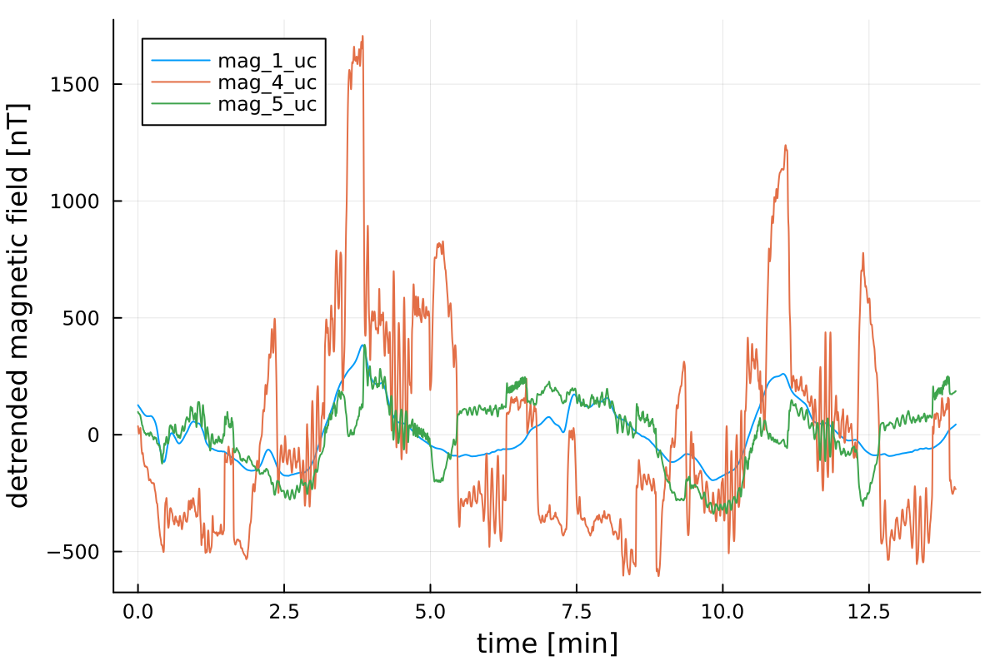

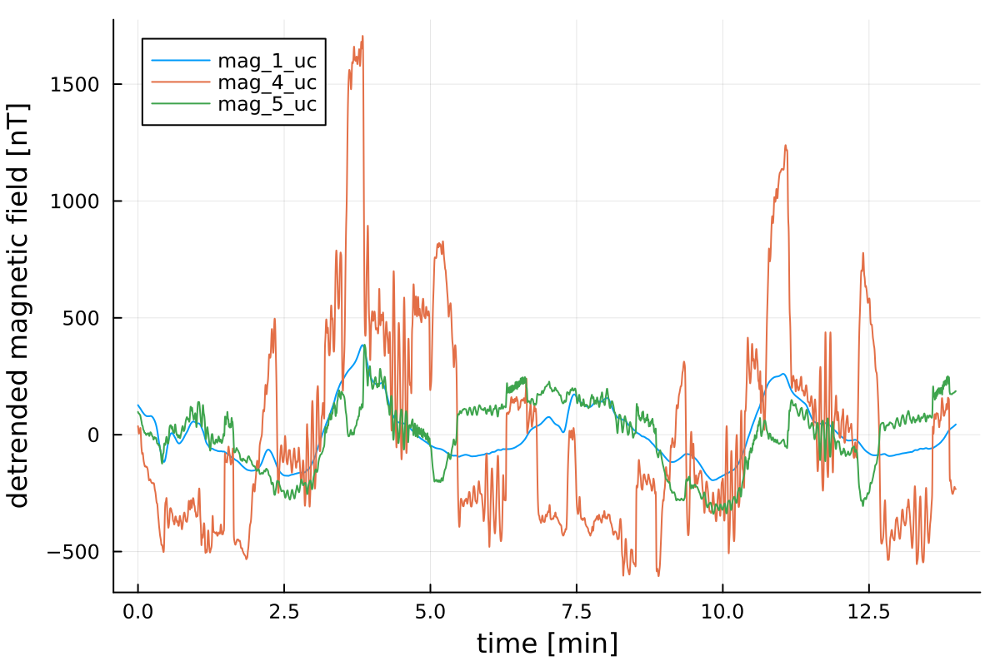

In [8]:
show_plot = true
save_plot = false
use_mags  = [:mag_1_uc,:mag_4_uc,:mag_5_uc] # scalar magnetometers to plot

p1 = plot_mag(xyz;ind,show_plot,save_plot, # plot scalar magnetometers
              use_mags     = use_mags,
              detrend_data = true); # 추세를 제거할 것인지

# 1이 cabin 밖에서 측정한거고, 4,5는 cabin 안에서 측정한 것이다.
# Mag 1에 비해서 안에서 측정한 것들은 노이즈가 크다


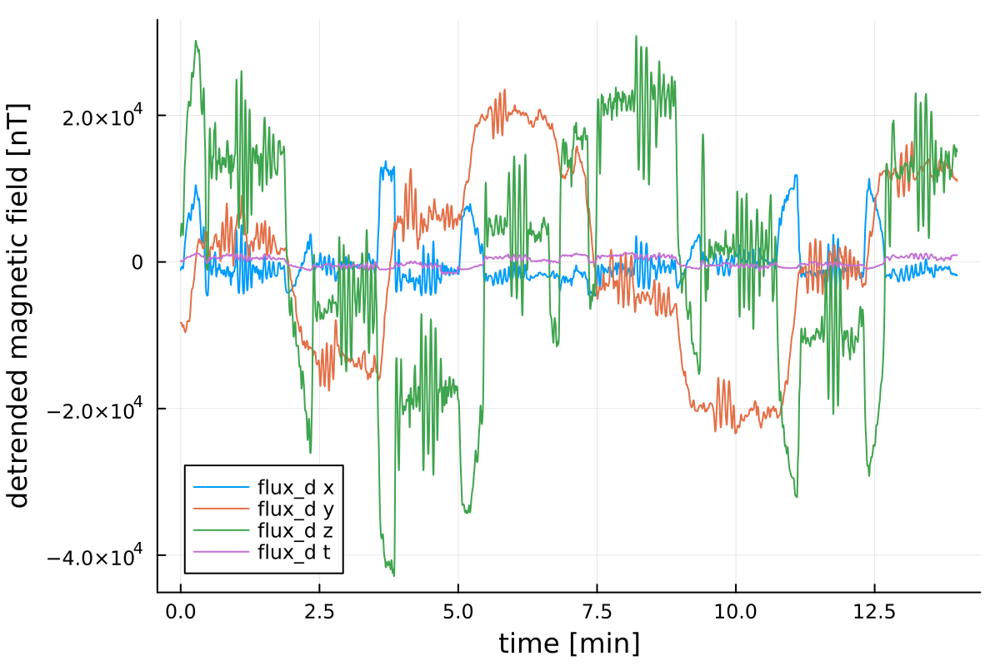

In [32]:
p2 = plot_mag(xyz;ind,show_plot,save_plot, # plot vector magnetometer (fluxgate)
              use_mags     = [:flux_d], # try changing to :flux_a, :flux_b, :flux_c
              detrend_data = true);


Clearly, the in-cabin scalar and vector magnetometers are noisy compared to the stinger magnetometer (Mag 1).

## Create the (linear) Tolles-Lawson model

Next, we select scalar and vector magnetometer readings during the calibration flight and generate the coefficients to perform linear Tolles-Lawson compensation. We are choosing in-cabin scalar magnetometer 4 and vector (flux) magnetometer D. Mag 4 is located on the floor in the rear of the cabin, and Flux D is nearby on the starboard side. Mag 4 is particularly challenging since it contains several 100s to 1000 nT excursions in comparison to the tail stinger.

### Tolles-Lawson calibration

분명히 기내 스칼라 및 벡터 자력계는 스팅거 자력계(Mag 1)에 비해 잡음이 큽니다.
Mag1이 제일 정확함.

## (선형) 톨레스-로슨 모델 만들기

다음으로, 보정 비행 중 스칼라 및 벡터 자력계 판독값을 선택하고 선형 톨레스-로슨 보정을 수행하기 위한 계수를 생성합니다. 기내 스칼라 자력계 4와 벡터(플럭스) 자력계 D를 선택합니다. Mag 4는 기내 뒤쪽 바닥에, Flux D는 우현 부근에 있습니다. 마그 4는 테일 스팅어에 비해 100~1000nT의 편차를 포함하고 있어 특히 까다롭습니다.

### 톨레스-로슨 보정

항공기 자체의 자기장이 비행 방향, 항공기의 각도, 항공기 내부의 전기적 활동(전류 흐름) 같은 여러 요소에 의해 변화함

이 코드에서는 fluxD 측정값과 Mag4의 스칼라 지기계 측정 값으로 regression

In [9]:
λ       = 0.025   # ridge parameter for ridge regression
use_vec = :flux_d # selected vector (flux) magnetometer
flux    = getfield(xyz,use_vec) # load Flux D data
TL_d_4  = create_TL_coef(flux,xyz.mag_4_uc,TL_ind;λ=λ); # create Tolles-Lawson coefficients with Flux D & Mag 4

### Tolles-Lawson compensation

create_TL_A는 Flux D 측정값과 인덱스로 보정에 필요한 A godfuf todtjd
mag_1을 GT로 사용
보정되지 않은 Mag4 측정값 로드
이후 Mag4 보정

In [10]:
A = create_TL_A(flux,ind)     # Tolles-Lawson `A` matrix for Flux D
mag_1_sgl = xyz.mag_1_c[ind]  # professionally compensated tail stinger, Mag 1
mag_4_uc  = xyz.mag_4_uc[ind] # uncompensated Mag 4
mag_4_c   = mag_4_uc - detrend(A*TL_d_4;mean_only=true); # compensated Mag 4


## Navigation

Here, several steps are done to prepare the flight and map data for the navigation filter. The trajectory (`Traj`) and `INS` data structures are pulled out of the `XYZ20` data structure for convenience, and map data is loaded into a map (`MapS`) data structure. The map is then "upward continued" (via a Fast Fourier Transform) to the trajectory altitude and outfitted with an interpolation function (`itp_mapS`). Finally, the expected scalar magnetometer reading along the flight path (`map_val`) is computed using the interpolation function, as done in `get_map_val()`, then corrected for diurnal effects and the core magnetic field ([IGRF](https://www.ncei.noaa.gov/products/international-geomagnetic-reference-field)).

## 내비게이션

여기에서는 내비게이션 필터를 위한 비행 및 지도 데이터를 준비하기 위해 몇 가지 단계가 수행됩니다. 궤적(`Traj`) 및 `INS` 데이터 구조는 편의를 위해 `XYZ20` 데이터 구조에서 가져오고, 지도 데이터는 지도(`MapS`) 데이터 구조에 로드합니다. 그런 다음 지도는 고속 푸리에 변환을 통해 궤도 고도까지 '상향 계속'되고 보간 함수(`itp_mapS`)가 장착됩니다. 마지막으로, 비행 경로를 따라 예상되는 스칼라 자력계 수치(`map_val`)는 `get_map_val()`에서와 같이 보간 함수를 사용하여 계산한 다음 일별 효과와 중심 자기장([IGRF](https://www.ncei.noaa.gov/products/international-geomagnetic-reference-field))에 대해 보정합니다.



In [11]:
traj = get_traj(xyz,ind) # 항공기의 위치(위도, 경도, 고도 등) GPS 데이터
ins  = get_ins( xyz,ind;N_zero_ll=1) # INS struct, "zero" lat/lon to match first `traj` data point 항공기의 속도, 방향, 각속도
mapS = get_map(map_name,df_map) # load map data 지도 데이터나 자기 이상 데이터
# get map values & map interpolation function
# mapS에서 제공된 지도 데이터와 traj에서 제공된 비행 궤적을 기반으로 지도 값과 지도 보간 함수를 반환
(map_val,itp_mapS) = get_map_val(mapS,traj;return_itp=true)
map_val += (xyz.diurnal + xyz.igrf)[ind] # add in diurnal & core (IGRF)
# 일변화(diurnal) 및 국제 지자기 참조 필드(IGRF) 값에 기반한 핵 자기장을 map_val에 추가
println("Error for scalar Mag 4: ",round(std(map_val-mag_4_c),digits=2)," nT")
# 보정된 스칼라 자기계 측정값(mag_4_c)과 예측된 자기 이상 값(map_val) 사이의 표준편차를 계산

Error for scalar Mag 4: 133.68 nT


### Create the filter model

Next, we do a rough analysis to estimate appropriate filter parameters, and then we initialize a filter model. Specifically, the autocorrelation between the measured (`mag_4_c`) and true (`map_val`) magnetic values is evaluated. This provides information for setting the magnitudes of the measurement variance `meas_var` and first-order Gauss-Markov (FOGM) standard deviation (`fogm_sigma`) and time constant (`fogm_tau`). These are all approximate, and may not be consistently appropriate for the entire flight line.

측정된 자기값 (mag_4_c)와 실제 자기값(map_val)사이의 자기 상관을 이용해서 학습하도록 함.

-측정 분산(meas_var): 측정 과정에서 발생하는 불확실성의 정도를 나타내는 매개변수입니다. 이 값은 측정된 자기값과 실제 자기값 사이의 차이(오차)의 분산을 기반으로 설정됩니다.

-1차 가우스-마르코프(Gauss-Markov) 표준 편차(fogm_sigma): 이 매개변수는 시간에 따른 오차의 변화율을 나타내며, 오차가 가우스-마르코프 과정을 따른다고 가정할 때의 표준 편차를 의미합니다.

-가우스-마르코프 시간 상수(fogm_tau): 이는 오차가 자기 상관을 잃어가는 시간적 특성을 나타내는 매개변수입니다. 시간 상수는 오차가 초기 상태에서 얼마나 빠르게 변화하는지를 나타내며, 오차 과정의 "기억"이 얼마나 지속되는지를 결정합니다.

In [12]:
(sigma,tau) = get_autocor(mag_4_c - map_val)


(134, 10)

In [13]:
(P0,Qd,R) = create_model(traj.dt,traj.lat[1];
                         init_pos_sigma = 0.1,
                         init_alt_sigma = 1.0,
                         init_vel_sigma = 1.0,
                         meas_var       = 134^2, # increase for bad mag
                         fogm_sigma     = 134,
                         fogm_tau       = 10.0);

# 비행 궤적 데이터 traj에서 제공된 tarj.dt와 초기 위도 tarj.lat[1]를 기반으로 모델의 초기값을 설정
# init 값들은 초기값에 대한 불확실성(표준편차)을 나타냄
# meas_var은 측정값의 불확실성을 나타내며, 측정 값의 품질이 좋지 않을 때 높은 값을 사용
# fogm_sigma와 fogm_tau는 first order Gauss-Markov process의 시간 상수와 표준편차를 나타냄

([2.449994703380772e-16 0.0 … 0.0 0.0; 0.0 4.870148497135901e-16 … 0.0 0.0; … ; 0.0 0.0 … 5.28529e-17 0.0; 0.0 0.0 … 0.0 17956.0], [1.0e-31 0.0 … 0.0 0.0; 0.0 1.0e-31 … 0.0 0.0; … ; 0.0 0.0 … 2.9362722222222226e-21 0.0; 0.0 0.0 … 0.0 359.12], 17956)

### Run the filter

Here, we use an extended Kalman filter (`:ekf`) and compute:
- `crlb_out`: Cramér–Rao lower bound error
- `ins_out`: error when using the INS alone (dead reckoning)
- `filt_out`: error when using the INS + magnetic measurements (MagNav)

### 필터 실행

여기서는 확장된 칼만 필터(`:ekf`)를 사용하여 계산합니다:
- crlb_out`: 크라메르-라오 하한 에러
- `ins_out`: INS만 사용할 때의 오류(데드 레코딩)
- `filt_out`: INS + 자기 측정(MagNav) 사용 시 에러

In [14]:
mag_use = mag_4_c # select Mag 4 for navigation
mag_use .+= map_val[1] - mag_use[1] # remove initial DC offset
(crlb_out,ins_out,filt_out) = run_filt(traj,ins,mag_use,itp_mapS,:ekf;P0,Qd,R,core=true); # run the filter


┌ Info: CRLB DRMS error = 395 m
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/eval_filt.jl:283
┌ Info: FILT DRMS error = 149 m
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/eval_filt.jl:424


### Plot the results

Despite the 149 m distance-root-mean-square (DRMS) error, the navigation does not go too far awry for the linear model.

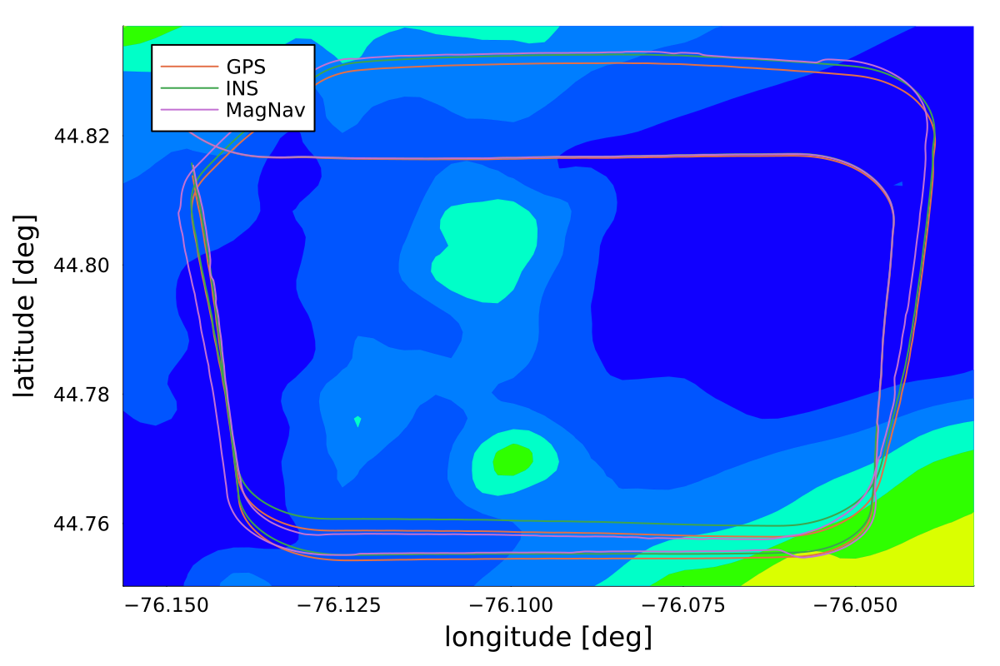

In [15]:
p3 = plot_map(mapS;legend=false); # plot map background
plot_filt!(p3,traj,ins,filt_out;show_plot=false); # plot GPS, INS (after zeroing), and filter
plot!(p3,legend=:topleft) # move legend as desired


### Corrupting fields

In the below plot, there are some spiky excursions in the TL-compensated magnetometer that do not occur on the map. We can easily compare the two using the `plot_mag_map` convenience function.

### 손상된 필드

아래 플롯에서 TL 보정 자력계에는 지도에는 나타나지 않는 급격한 편차가 있습니다. 'plot_mag_map' 편의 함수를 사용하여 이 둘을 쉽게 비교할 수 있습니다.

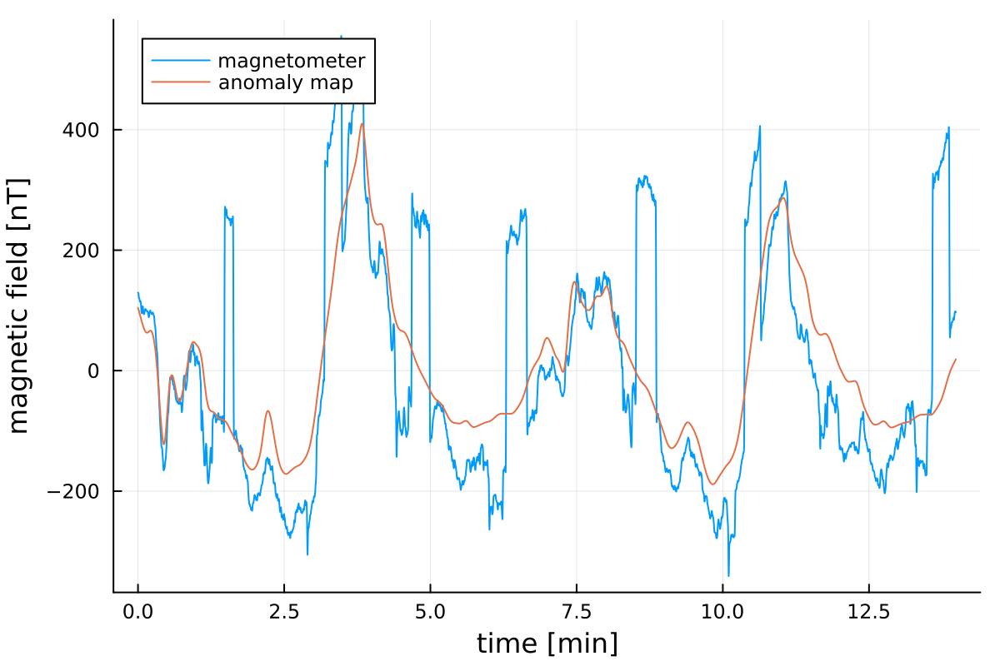

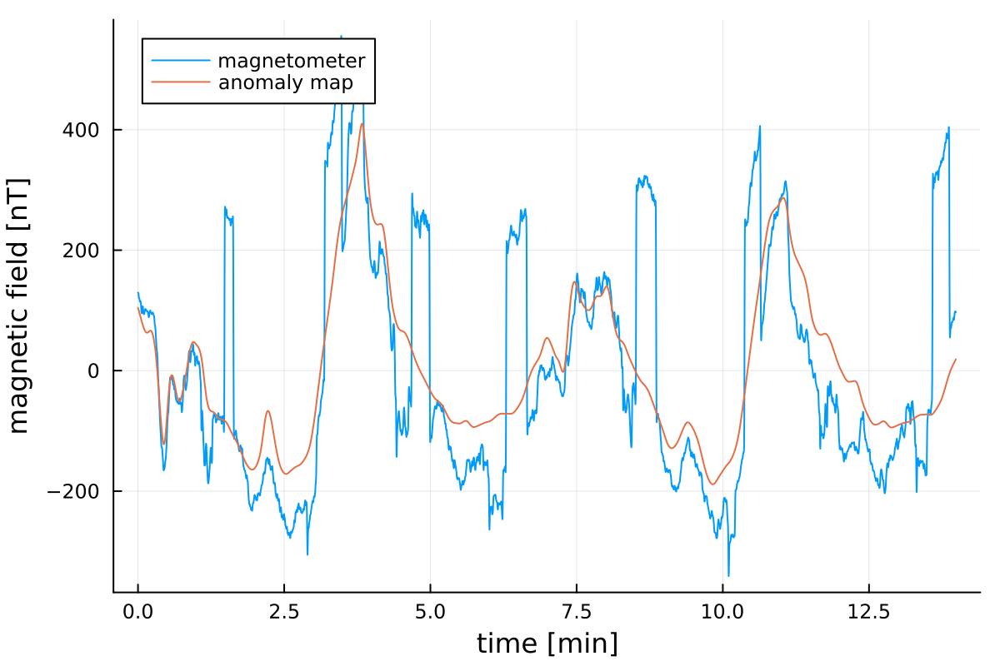

In [16]:
p4 = plot_mag_map(traj,mag_use,itp_mapS) # plot magnetometer vs map


However, current sensors for the 💡 strobe lights 💡 picked some of these up. The current sensors have severe high-frequency noise, so we first low-pass filter them using two convenience functions, `get_bpf` and `bpf_data`.

그러나 💡 스트로브 라이트의 전류 센서가 이 중 일부를 포착했습니다. 전류 센서에는 고주파 노이즈가 심하기 때문에 먼저 두 가지 편의 함수인 `get_bpf`와 `bpf_data`를 사용하여 저역 통과 필터를 적용합니다.

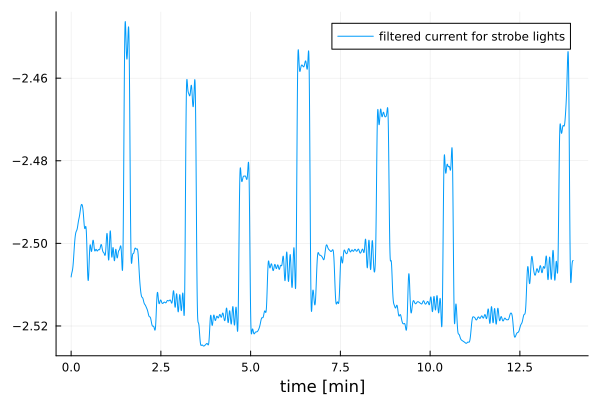

In [41]:
lpf     = get_bpf(;pass1=0.0,pass2=0.2,fs=10.0) # get low-pass filter
lpf_sig = -bpf_data(xyz.cur_strb[ind];bpf=lpf)  # apply low-pass filter, sign switched for easier comparison
p5      = plot_basic(xyz.traj.tt[ind],lpf_sig;lab="filtered current for strobe lights"); # plot the low-pass filtered strobe light current sensor


## Training a physics-based neural network architecture

Now we attempt to improve on the prior results by training a neural network that incorporates the Tolles-Lawson (TL) model together with an artificial neural network (NN). Specifically, the NN is provided with cabin current sensor information that produces an additive correction to the TL model. Both the NN parameters and the TL coefficients are trainable, which we designate as model 2c (model 2b, by comparison, keeps the TL coefficients static).

First, we select all available flight data from Flights 1003-1006 (see [readmes](https://github.com/MIT-AI-Accelerator/MagNav.jl/tree/master/readmes)) into `lines_train`, except the held-out flight `line`. The full list of flight lines is in `df_all`.

## 물리 기반 신경망 아키텍처 훈련하기

이제 인공 신경망(NN)과 함께 톨레스-로슨(TL) 모델을 통합한 신경망을 훈련하여 이전 결과를 개선하려고 시도합니다. 구체적으로, NN에는 객실 전류 센서 정보가 제공되어 TL 모델에 추가 보정을 생성합니다. NN 파라미터와 TL 계수는 모두 학습 가능하며, 이를 모델 2c로 지정합니다(이에 비해 모델 2b는 TL 계수를 정적으로 유지).

먼저, 1003-1006 항공편([readmes](https://github.com/MIT-AI-Accelerator/MagNav.jl/tree/master/readmes) 참조)에서 보류된 항공편 `line`을 제외한 사용 가능한 모든 비행 데이터를 `lines_train`으로 선택합니다. 전체 비행 노선 목록은 `df_all`에 있습니다.

In [17]:
flts = [:Flt1003,:Flt1004,:Flt1005,:Flt1006] # 학습될 항공편
df_train = df_all[(df_all.flight .∈ (flts,) ) .& # df_all의 fligt 열에 있는 항목이 flts에 있는지 확인
                  (df_all.line   .!= line),:]    # 1006.08을 제외한 모든 항공편의 데이터를 선택
lines_train = df_train.line # training lines


48-element Vector{Float64}:
 1003.01
 1003.02
 1003.03
 1003.04
 1003.05
 1003.06
 1003.07
 1003.08
 1003.09
 1003.11
    ⋮
 4002.0
 1005.02
 1006.01
 1006.03
 1006.04
 1006.05
 1006.06
 1006.07
 1006.09

Here, we add current sensors to the usual inputs, making them available to the neural network. 

여기서는 일반적인 입력에 전류 센서를 추가하여 신경망에서 사용할 수 있도록 합니다.


- `:mag_4_uc`: 보정되지 않은 Mag 4 자기계 측정값을 나타냅니다. 이는 항공기 내부에 위치한 스칼라 자력계에서 얻은 자기장 측정값을 의미합니다.
- `:lpf_cur_com_1`: 저주파 통과 필터(Low Pass Filter, LPF)를 적용한 1번 커뮤니케이션 시스템의 전류 측정값입니다. 저주파 통과 필터는 높은 주파수의 노이즈를 제거하여 신호를 평활화하는 데 사용됩니다.
- `:lpf_cur_strb`: 저주파 통과 필터를 적용한 항공기의 스트로브 조명(Strobe Lights) 전류 측정값입니다.
- `:lpf_cur_outpwr`: 저주파 통과 필터를 적용한 항공기의 외부 전력 공급 장치의 전류 측정값입니다.
- `:lpf_cur_ac_lo`: 저주파 통과 필터를 적용한 항공기의 저압(AC Low) 전류 측정값입니다.

In [22]:
features = [:mag_4_uc, :lpf_cur_com_1, :lpf_cur_strb, :lpf_cur_outpwr, :lpf_cur_ac_lo];

The neural network-based compensation parameters (type of `NNCompParams`) are provided to (and returned by) the training function. These take default values unless they are specified.


- `features_setup`: 모델 학습에 사용될 특성들의 목록을 지정합니다. 여기서는 앞서 정의된 `features` 변수가 사용됩니다.
  
- `model_type`: 모델의 유형을 지정합니다. `:m2c`는 특정 신경망 구조나 학습 전략을 의미할 수 있습니다.
  
- `y_type`: 예측하려는 타겟 변수의 유형을 지정합니다. `:d`는 가능하게는 자기 이상 탐지나 자기장의 특정 성분과 같은 구체적인 타겟을 의미할 수 있습니다.
  
- `use_mag`: 사용할 자기계 측정값을 지정합니다. 여기서는 `:mag_4_uc`가 선택되어, 보정되지 않은 Mag 4 측정값을 사용합니다.
  
- `use_vec`: 사용할 벡터 자기계 측정기를 지정합니다. `:flux_d`는 Flux D 측정값을 나타냅니다.
  
- `terms`: 모델에 포함할 자기장 기여 항목들을 나열합니다. 여기서는 영구적(permanent), 유도된(induced), 그리고 유동 자기장 모델(fdm) 항목이 포함됩니다.
  
- `terms_A`: `A` 행렬에 적용될 항목들을 지정합니다. 여기서는 영구적, 유도된, 에디 전류(eddy) 관련 항목이 포함됩니다.
  
- `sub_diurnal`: 일변화(diurnal) 자기장 기여를 제거할지 여부를 지정합니다.
  
- `sub_igrf`: 국제 지자기 참조 필드(IGRF) 관련 기여를 제거할지 여부를 지정합니다.
  
- `bpf_mag`: 자기계 측정값에 대한 대역통과 필터(band-pass filter) 적용 여부를 지정합니다.
  
- `norm_type_A`, `norm_type_x`, `norm_type_y`: 각각 `A` 행렬, 입력 특성(`x`), 타겟 변수(`y`)에 대한 정규화 유형을 지정합니다.
  
- `TL_coef`: Tolles-Lawson 모델에 사용될 계수를 지정합니다. 여기서는 `TL_d_4`가 사용됩니다.
  
- `η_adam`, `epoch_adam`: Adam 최적화 알고리즘에 사용될 학습률과 에폭(epoch) 수를 지정합니다.
  
- `epoch_lbfgs`: L-BFGS 최적화 알고리즘에 사용될 에폭 수를 지정합니다.
  
- `hidden`: 신경망의 은닉층 구성을 지정합니다. 여기서는 8개의 노드를 가진 첫 번째 은닉층과 4개의 노드를 가진 두 번째 은닉층을 사용합니다.

In [23]:
comp_params = NNCompParams(features_setup = features,
                           model_type     = :m2c,
                           y_type         = :d,
                           use_mag        = :mag_4_uc,
                           use_vec        = :flux_d,
                           terms          = [:permanent,:induced,:fdm],
                           terms_A        = [:permanent,:induced,:eddy],
                           sub_diurnal    = true,
                           sub_igrf       = true,
                           bpf_mag        = false,
                           norm_type_A    = :none,
                           norm_type_x    = :standardize,
                           norm_type_y    = :standardize,
                           TL_coef        = TL_d_4,
                           η_adam         = 0.001,
                           epoch_adam     = 300,
                           epoch_lbfgs    = 0,
                           hidden         = [8,4]);


# compensation.jl 에 있는 내용

`nn_comp_2_fwd` 함수는 신경망 모델을 사용하여 입력 데이터 `x_norm`에 대한 예측 `y_hat`을 계산하는데, 다양한 모델 유형(`model_type`)에 따라 예측 방식이 달라집니다. 특히 `model_type`이 `:m2c`일 때의 처리 방식에 대해 설명하겠습니다.

### `model_type`이 `:m2c`일 때의 처리 과정:

1. **신경망 모델 실행**: `y_hat = vec(m(x_norm)) + A_norm'*TL_coef_norm`
   - `m(x_norm)`: 입력 데이터 `x_norm`에 대해 신경망 모델 `m`을 적용합니다. 이 과정에서 신경망은 주어진 입력에 대한 예측 값을 생성합니다.
   - `vec(...)`: 결과 벡터를 일렬로 펼칩니다. 이는 신경망의 출력을 1차원 벡터로 변환하는 과정입니다.
   - `A_norm'*TL_coef_norm`: 행렬 `A_norm`의 전치(transpose)와 벡터 `TL_coef_norm`의 내적(dot product)을 계산합니다. `TL_coef_norm`는 정규화된 변환 계수(transform coefficients)를 나타내며, 모델의 예측에 추가적인 조정을 적용하는 데 사용됩니다.

2. **결과의 비정규화**: `denorm && (y_hat .= denorm_sets(y_bias,y_scale,y_hat))`
   - `denorm_sets(y_bias,y_scale,y_hat)`: 예측 값 `y_hat`을 비정규화하는 함수입니다. 이 함수는 `y_hat`에 적용된 정규화를 역으로 수행하여 실제 값의 범위로 변환합니다. 여기서 `y_bias`와 `y_scale`은 비정규화 과정에 사용되는 편향(bias)과 스케일(scale) 파라미터입니다.
   - `denorm` 플래그가 `true`일 경우에만 비정규화 과정이 수행됩니다. 이는 사용자가 모델의 출력을 실제 값의 범위로 조정할지 여부를 결정할 수 있게 합니다.

3. **`testmode` 설정**: `testmode && Flux.testmode!(m)`
   - 이 함수는 모델이 배치 정규화(batch normalization) 또는 드롭아웃(dropout)과 같은 특정 계층을 포함하고 있을 때, 모델을 테스트 모드로 설정합니다. 테스트 모드에서는 이러한 계층들이 학습 과정에서와 다르게 동작하며, 모델의 일관된 예측을 보장합니다.

`model_type`이 `:m2c`인 경우, 신경망 모델의 출력에 추가적으로 `A_norm`과 `TL_coef_norm`을 사용하여 예측값을 조정합니다. 이는 특정 애플리케이션에서 모델의 예측에 추가적인 정보나 조건을 반영하기 위해 사용될 수 있습니다.

In [45]:
(comp_params,y_train,y_train_hat,err_train,feats) =
    comp_train(comp_params,lines_train,df_all,df_flight,df_map);


┌ Info: epoch 0: loss = 9.103811
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:458
┌ Info: epoch 5: loss = 0.09333775
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 10: loss = 0.065605305
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 10 train error: 75.43 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 15: loss = 0.056031723
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 20: loss = 0.045709487
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 20 train error: 62.86 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 25: loss = 0.037950978
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 30: loss = 0.032504212
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 30 train error: 52.73 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 35: loss = 0.028264996
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 40: loss = 0.0258975
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 40 train error: 46.15 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 45: loss = 0.024368258
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 50: loss = 0.023445811
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 50 train error: 43.88 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 55: loss = 0.022857528
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 60: loss = 0.022470575
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 60 train error: 43.01 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 65: loss = 0.02183524
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 70: loss = 0.021339303
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 70 train error: 41.93 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 75: loss = 0.02081007
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 80: loss = 0.020307904
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 80 train error: 40.93 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 85: loss = 0.01981798
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 90: loss = 0.019387584
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 90 train error: 40.0 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 95: loss = 0.019040395
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 100: loss = 0.01864013
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 100 train error: 39.47 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 105: loss = 0.01853385
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 110: loss = 0.018257778
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 110 train error: 38.77 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 115: loss = 0.018120954
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 120: loss = 0.017930485
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 120 train error: 38.28 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 125: loss = 0.01789394
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 130: loss = 0.017688023
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 130 train error: 38.4 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 135: loss = 0.017591191
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 140: loss = 0.017591191
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 140 train error: 37.88 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 145: loss = 0.017500855
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 150: loss = 0.017471392
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 150 train error: 37.89 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 155: loss = 0.017424038
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 160: loss = 0.017395396
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 160 train error: 37.9 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 165: loss = 0.017283771
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 170: loss = 0.017283771
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 170 train error: 37.69 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 175: loss = 0.017233614
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 180: loss = 0.017197724
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 180 train error: 37.63 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 185: loss = 0.017197719
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 190: loss = 0.017112488
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 190 train error: 37.7 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 195: loss = 0.017112488
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 200: loss = 0.017071567
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 200 train error: 37.72 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 205: loss = 0.01696651
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 210: loss = 0.01696651
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 210 train error: 37.71 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 215: loss = 0.016915658
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 220: loss = 0.01684636
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 220 train error: 37.37 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 225: loss = 0.016812429
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 230: loss = 0.016784469
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 230 train error: 37.04 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 235: loss = 0.016784469
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 240: loss = 0.016690498
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 240 train error: 37.23 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 245: loss = 0.016686466
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 250: loss = 0.016658742
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 250 train error: 37.37 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 255: loss = 0.016658742
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 260: loss = 0.016641641
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 260 train error: 37.04 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 265: loss = 0.016601974
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 270: loss = 0.016528329
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 270 train error: 36.88 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 275: loss = 0.016511299
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 280: loss = 0.016507363
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 280 train error: 37.12 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: epoch 285: loss = 0.01648692
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: epoch 290: loss = 0.01648692
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: 290 train error: 36.92 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492


┌ Info: epoch 295: loss = 0.01640377
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472
┌ Info: epoch 300: loss = 0.01640377
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:472


┌ Info: 300 train error: 37.05 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:492
┌ Info: train error: 36.87 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:529


┌ Info: time: 1.3 min
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:4179


여기서 `1`은 표준 피드포워드 신경망을 나타내며, `2`와 `3`은 Tolles-Lawson 모델과 결합하여 사용됩니다. 각 모델 타입의 설명은 다음과 같습니다:

- **`:m1`**: 표준 피드포워드 신경망(Feedforward Neural Network, NN)입니다. 이는 다층 퍼셉트론(MLP)과 유사한 기본적인 신경망 구조로, 입력에서 출력으로의 직접적인 데이터 흐름(피드포워드)을 특징으로 합니다.

- **`:m2a`**: 신경망(NN)이 Tolles-Lawson(TL) 계수를 결정합니다. 이 아키텍처에서 NN은 TL 모델의 계수를 최적화하는 역할을 합니다.

- **`:m2b`**: 신경망이 전통적인 TL 모델에 추가적인 보정을 결정합니다. 여기서 NN은 기존의 TL 계수에 대한 추가적인 수정값을 제공하여 모델의 성능을 개선합니다.

- **`:m2c`**: 신경망이 전통적인 TL에 대한 추가적인 보정을 결정하며, TL 계수도 함께 조정됩니다. 이는 `:m2b`의 확장된 형태로, NN에 의해 제공되는 보정뿐만 아니라 TL 계수 자체도 학습 과정에서 최적화됩니다.

- **`:m2d`**: 신경망이 각각의 TL 계수에 대한 추가적인 보정을 결정합니다. 이 모델은 TL 계수 각각에 대해 개별적인 수정값을 NN을 통해 산출합니다.

- **`:m3tl`**: 신경망 없이 TL 계수를 SGD(Stochastic Gradient Descent)를 통해 미세 조정합니다. 이 모델은 `y_type` :b 및 :c에 대해 Taylor 확장을 사용하지 않으며, 순수하게 TL 계수의 최적화에 초점을 맞춥니다.

- **`:m3s`**: 신경망이 TL에 대한 스칼라 보정을 결정합니다. TL 벡터 항을 확장하여 설명 가능성을 높이는 것을 목표로 합니다.

- **`:m3v`**: 신경망이 TL에 대한 벡터 보정을 결정합니다. `:m3s`와 유사하게, TL 벡터 항을 확장하여 모델의 설명 가능성을 높이는 방식입니다.

- **`:m3sc`**: `:m3s` 모델을 사용하되, TL 오류에 기반한 커리큘럼 학습을 적용합니다.

- **`:m3vc`**: `:m3v` 모델을 사용하되, TL 오류에 기반한 커리큘럼 학습을 적용합니다.

- **`:m3w`**: 시계열 데이터셋에 대한 창(Window) 신경망을 사용한 `:m3s` 모델입니다.

- **`:m3tf`**: 시계열 데이터셋에 대한 시계열 변환기(Time Series Transformer)를 사용한 `:m3s` 모델입니다.

각 모델은 다양한 접근 방식과 기술을 사용하여 자기 이상 내비게이션 시스템에서의 위치 추정 및 자기장 보정의 정확도를 개선하는 것을 목표로 합니다. 모델 선택은 특정 응용 프로그램의 요구 사항,

After 300 epochs, model 2c has 37 nT of error on the training data. We next test the performance on the held-out flight `line` using the `comp_test` convenience function. Note that there is also a `comp_train_test` convenience function that does both.

In [46]:
(_,y_hat,_) =
    comp_test(comp_params,[line],df_all,df_flight,df_map);


┌ Info: test  error: 57.3 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:661
┌ Info: time: 0.7 sec
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:4177


We are now in a position to compare the magnetometer readings to the expected map values. The model 2c results ameliorate the signal excursions that are present in the uncompensated and TL-compensated readings. 

Note that the `detrend` function helps remove any persistent bias in the signal, which does not affect the navigation error.

이제 자력계 판독값을 예상 지도 값과 비교할 수 있는 위치에 있습니다. 모델 2c 결과는 보정되지 않은 판독값과 TL 보정된 판독값에 존재하는 신호 편차를 개선합니다. 

'디트렌드' 기능은 내비게이션 오류에 영향을 주지 않는 신호의 지속적인 편향을 제거하는 데 도움이 됩니다.

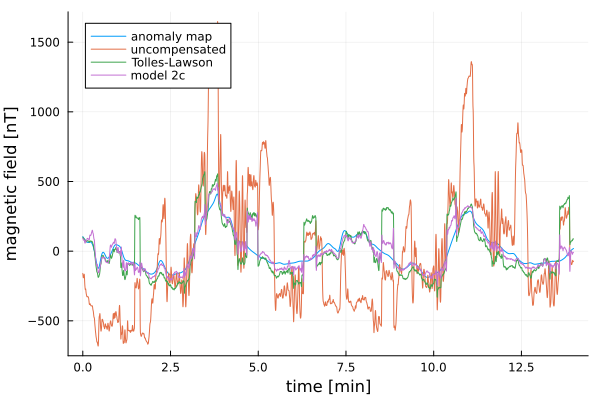

In [47]:
tt = (xyz.traj.tt[ind] .- xyz.traj.tt[ind][1]) / 60;
p6 = plot(xlab="time [min]", ylab="magnetic field [nT]");
plot!(p6, tt, detrend(map_val  - (xyz.diurnal + xyz.igrf)[ind], mean_only=true), lab="anomaly map");
plot!(p6, tt, detrend(mag_4_uc - (xyz.diurnal + xyz.igrf)[ind], mean_only=true), lab="uncompensated");
plot!(p6, tt, detrend(mag_4_c  - (xyz.diurnal + xyz.igrf)[ind], mean_only=true), lab="Tolles-Lawson");
plot!(p6, tt, detrend(mag_4_uc - y_hat - (xyz.diurnal + xyz.igrf)[ind], mean_only=true), lab="model 2c")


Next, we use the NN output to perform the compensation. Since we selected `y_type = :d` in the NN compensation parameters (`NNCompParams`), we treat the output as the platform component that must be subtracted from the total scalar signal.

다음으로 NN 출력을 사용하여 보정을 수행합니다. NN 보정 파라미터(`NNCompParams`)에서 `y_type = :d`를 선택했으므로 출력을 전체 스칼라 신호에서 빼야 하는 플랫폼 구성 요소로 취급합니다.

In [48]:
mag_use = mag_4_uc - y_hat # compensate Mag 4 using NN output
mag_use .+= map_val[1] - mag_use[1] # remove initial DC offset
println("TL + NN σ: ",round(std(map_val-mag_use),digits=2))
println("TL σ:      ",round(std(mag_4_c.+(map_val[1]-mag_4_c[1])-map_val),digits=2))
(sigma,tau) = get_autocor(mag_use - map_val)


TL + NN σ: 55.68
TL σ:      133.68


(56, 10)

Finally, we use these results in an extended Kalman filter (EKF) to check navigation performance.

마지막으로 이러한 결과를 확장 칼만 필터(EKF)에 사용하여 탐색 성능을 확인합니다.

In [49]:
(P0,Qd,R) = create_model(traj.dt,traj.lat[1];
                         init_pos_sigma = 0.1,
                         init_alt_sigma = 1.0,
                         init_vel_sigma = 1.0,
                         meas_var       = 56^2, # increase for bad mag
                         fogm_sigma     = 56,
                         fogm_tau       = 10);

(crlb_out,ins_out,filt_out) = run_filt(traj,ins,mag_use,itp_mapS,:ekf;P0,Qd,R,core=true);


┌ Info: CRLB DRMS error = 243 m
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/eval_filt.jl:283
┌ Info: FILT DRMS error = 78 m
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/eval_filt.jl:424


The physics informed neural network outperforms the linear model!

The notebook continues below to show a similar comparison using a "vanilla" neural network (no linear model). We also provide results for model 2b, which leaves the TL coefficients as constant in the NN learning process. To reproduce the model 2b results, simply replace `model_type = :m2c` with `model_type = :m2b` above and replace the `fogm_sigma` and `fogm_tau` values with the corresponding outputs from `plot_autocor`.

물리 정보에 기반한 신경망이 선형 모델보다 성능이 뛰어납니다!

아래 노트북에서는 "바닐라" 신경망(선형 모델 없음)을 사용해 비슷한 비교를 계속합니다. 또한 NN 학습 과정에서 TL 계수를 일정하게 유지하는 모델 2b의 결과도 제공합니다. 모델 2b 결과를 재현하려면 위의 `model_type = :m2c`를 `model_type = :m2b`로 바꾸고 `fogm_sigma` 및 `fogm_tau` 값을 `plot_autocor`의 해당 출력으로 바꾸기만 하면 됩니다.

Model             | Mag Error [nT] | Nav Error [m]
----------------- | -------------- | -------
Tolles-Lawson     | 134            | 149 
TL + NN, model 2c | 55             | 74 
TL + NN, model 2b | 39             | 124 
vanilla NN        | 67             | 116 

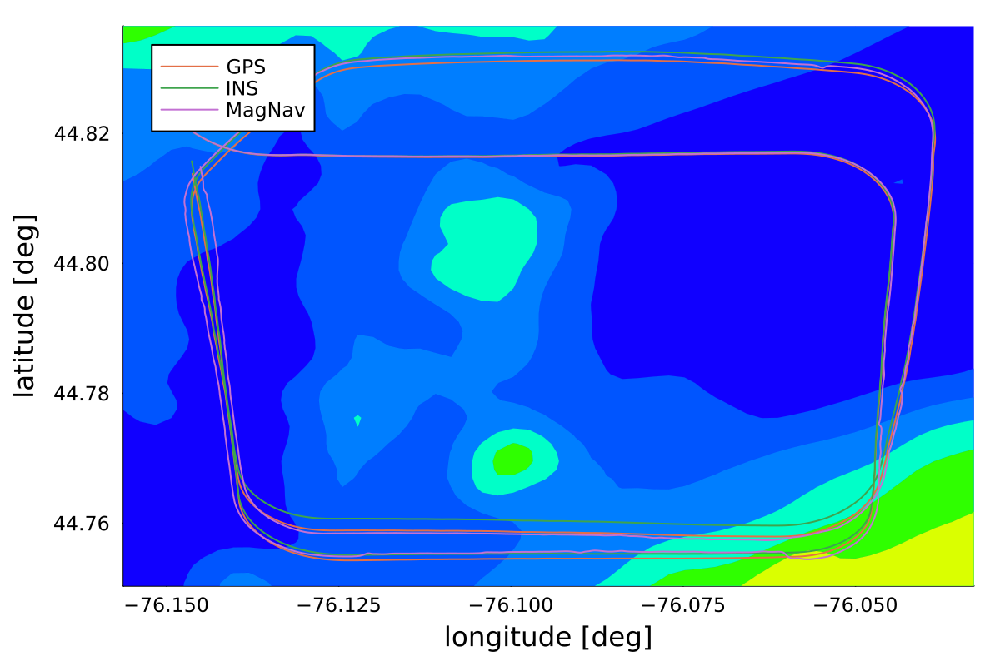

In [50]:
p7 = plot_map(mapS;legend=false); # plot map background
plot_filt!(p7,traj,ins,filt_out;show_plot=false); # plot GPS, INS (after zeroing), and filter
plot!(p7,legend=:topleft) # move legend as desired


## Bonus comparison to vanilla neural network

The above approaches used in-cabin vector (Flux D) and scalar (Mag 4) magnetometers, as well as current sensors. Here, we provide the same information to a "vanilla" neural network that does not contain embedded Tolles-Lawson information. We have simply added the vector (fluxgate) magnetometer to the feature list and changed to `model type = :m1`.

In [51]:
features = [:TL_A_flux_d, :mag_4_uc, :lpf_cur_com_1, :lpf_cur_strb, :lpf_cur_outpwr, :lpf_cur_ac_lo]
comp_params_vanilla = NNCompParams(features_setup = features,
                                   model_type     = :m1,
                                   y_type         = :d,
                                   use_mag        = :mag_4_uc,
                                   terms          = [:permanent,:induced,:fdm],
                                   sub_diurnal    = true,
                                   sub_igrf       = true,
                                   bpf_mag        = false,
                                   norm_type_x    = :standardize,
                                   norm_type_y    = :standardize,
                                   η_adam         = 0.001,
                                   epoch_adam     = 300,
                                   epoch_lbfgs    = 0,
                                   hidden         = [8,4]);


In [52]:
(comp_params_vanilla,y_train,y_train_hat,err_train,feats) =
    comp_train(comp_params_vanilla,lines_train,df_all,df_flight,df_map);


┌ Info: epoch 0: loss = 1.4111332
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:136
┌ Info: epoch 5: loss = 0.050104484
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 10: loss = 0.03173478
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 10 train error: 53.39 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 15: loss = 0.026603382
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 20: loss = 0.022233305
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 20 train error: 43.77 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 25: loss = 0.020022504
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 30: loss = 0.018187992
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 30 train error: 39.35 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 35: loss = 0.016326565
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 40: loss = 0.014651574
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 40 train error: 34.77 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 45: loss = 0.01339625
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 50: loss = 0.012545028
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 50 train error: 32.23 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 55: loss = 0.011997254
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 60: loss = 0.0116571635
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 60 train error: 30.88 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 65: loss = 0.011208574
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 70: loss = 0.010880516
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 70 train error: 30.06 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 75: loss = 0.01062258
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 80: loss = 0.01032835
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 80 train error: 29.07 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 85: loss = 0.010061914
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 90: loss = 0.009796335
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 90 train error: 27.71 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 95: loss = 0.009530386
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 100: loss = 0.009194168
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 100 train error: 26.72 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 105: loss = 0.009032762
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 110: loss = 0.008767625
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 110 train error: 25.5 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 115: loss = 0.008600534
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 120: loss = 0.00842806
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 120 train error: 24.74 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 125: loss = 0.008305963
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 130: loss = 0.008248187
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 130 train error: 24.41 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 135: loss = 0.008141582
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 140: loss = 0.008091465
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 140 train error: 24.16 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 145: loss = 0.008007627
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 150: loss = 0.007937132
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 150 train error: 23.92 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 155: loss = 0.007880857
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 160: loss = 0.007815794
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 160 train error: 23.88 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 165: loss = 0.007815794
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 170: loss = 0.0077554486
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 170 train error: 23.52 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 175: loss = 0.0077093197
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 180: loss = 0.007667151
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 180 train error: 23.31 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 185: loss = 0.00762762
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 190: loss = 0.0075836196
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 190 train error: 23.53 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 195: loss = 0.0075222254
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 200: loss = 0.0075222254
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 200 train error: 23.55 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 205: loss = 0.0074950145
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 210: loss = 0.007433304
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 210 train error: 23.08 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 215: loss = 0.0073885154
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 220: loss = 0.0073181577
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 220 train error: 22.99 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 225: loss = 0.00723691
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 230: loss = 0.00723691
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 230 train error: 22.71 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 235: loss = 0.0072118067
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 240: loss = 0.0071334285
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 240 train error: 22.58 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 245: loss = 0.007083429
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 250: loss = 0.0070001227
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 250 train error: 22.51 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 255: loss = 0.0070001227
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 260: loss = 0.0069563887
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 260 train error: 22.59 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 265: loss = 0.006914854
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 270: loss = 0.006872462
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 270 train error: 22.21 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 275: loss = 0.006805594
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 280: loss = 0.0067751296
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 280 train error: 22.49 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: epoch 285: loss = 0.006756596
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: epoch 290: loss = 0.006731084
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: 290 train error: 22.22 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159


┌ Info: epoch 295: loss = 0.00666424
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146
┌ Info: epoch 300: loss = 0.0066330684
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:146


┌ Info: 300 train error: 22.1 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:159
┌ Info: train error: 22.3 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:186


┌ Info: time: 57.8 sec
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:4177


In [54]:
(_,y_hat_vanilla,_) =
    comp_test(comp_params_vanilla,[line],df_all,df_flight,df_map);


┌ Info: test  error: 56.72 nT
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:281
┌ Info: time: 0.3 sec
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/compensation.jl:4177


In [55]:
mag_use = mag_4_uc - y_hat_vanilla # compensate Mag 4 using NN output
mag_use .+= map_val[1] - mag_use[1] # remove initial DC offset
println("NN σ: ",round(std(map_val-mag_use),digits=2))
println("TL σ: ",round(std(mag_4_c.+(map_val[1]-mag_4_c[1])-map_val),digits=2))
(sigma,tau) = get_autocor(mag_use - map_val)


NN σ: 56.46
TL σ: 133.68


(56, 12)

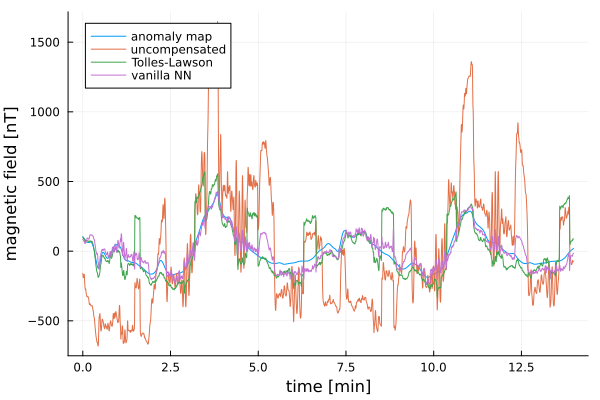

In [56]:
tt = (xyz.traj.tt[ind] .- xyz.traj.tt[ind][1]) / 60;
p8 = plot(xlab="time [min]", ylab="magnetic field [nT]");
plot!(p8, tt, detrend(map_val  - (xyz.diurnal + xyz.igrf)[ind], mean_only=true), lab="anomaly map");
plot!(p8, tt, detrend(mag_4_uc - (xyz.diurnal + xyz.igrf)[ind], mean_only=true), lab="uncompensated");
plot!(p8, tt, detrend(mag_4_c  - (xyz.diurnal + xyz.igrf)[ind], mean_only=true), lab="Tolles-Lawson");
plot!(p8, tt, detrend(mag_4_uc - y_hat_vanilla - (xyz.diurnal + xyz.igrf)[ind], mean_only=true), lab="vanilla NN")


In [57]:
(P0,Qd,R) = create_model(traj.dt,traj.lat[1];
                         init_pos_sigma = 0.1,
                         init_alt_sigma = 1.0,
                         init_vel_sigma = 1.0,
                         meas_var       = 56^2, # increase for bad mag
                         fogm_sigma     = 56,
                         fogm_tau       = 12);

(crlb_out,ins_out,filt_out) = run_filt(traj,ins,mag_use,itp_mapS,:ekf;P0,Qd,R,core=true);


┌ Info: CRLB DRMS error = 231 m
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/eval_filt.jl:283
┌ Info: FILT DRMS error = 141 m
└ @ MagNav /home/daehwa/.julia/packages/MagNav/DsmcU/src/eval_filt.jl:424


The vanilla neural network *does* do better than Tolles-Lawson alone, but not as well as model 2c.

We are continuing to work on ways to do more with less data.